In [39]:
import main_check_focus_exp as main
import sys
sys.path.append('/Users/qingjunwang/Documents/code/python')
import main_check_focus_exp as main
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np
import re
import io
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import shift

In [40]:
def shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr):
    """"
    shaking simulation used for laser driving where I need arrs of shaking angle range
    Parameters:
        dic_images_key_path(dic): {orginal_img_name(str):path(str)}
        amplitude_arr(arr): 
        image_pixel_per_um(float):
        select_color_chan(int): 0/1 for either grayscale image or color image
        color(str): 'red', 'green','blue'
        img_save_path(str):full path, ending at '/', and the system will create it if not exist
        crop_middle_third(int):0/1 for either non-crop or crop
        anglearr(list of list): look like [[0.0, 240.0], [720.0, 960.0]], from 0-240 degree and from 720 degree to 960 degree
    return: contrast(dic,with tuple as dic key), contrast[(orginal_img_name,amplitude_arr[j])]=scaled_img.std()/scaled_img.mean()
    """
    contrast={}
    radius_arr = np.ceil([amp * image_pixel_per_um for amp in amplitude_arr]) #in pixel
    sampling_arr = [np.ceil(amp/30*100) for amp in amplitude_arr] #1.8um per sampling on the trajectory
    for orginal_img_name, path in dic_images_key_path.items():
        img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
        if img is None:
            print(f"Failed to load image at {path}")
            continue
        if len(img.shape) == 2:
            img1 = img.astype(np.float32)
        elif len(img.shape) == 3:
            if select_color_chan==1:
                color_map = {'red': 2, 'green': 1, 'blue': 0}
                if color in color_map:
                    img1 = img[:, :, color_map[color]].astype(np.float32)
                else:
                    print(f"Invalid color specified: {color}")
                    continue
            else:
                img1=img.astype(np.float32)
        else:
            print(f"Unsupported image format at {path}")
            continues
        if crop_middle_third==1:
            height, width = img1.shape
            left = width // 3
            top = height // 3
            right = 2 * width // 3
            bottom = 2 * height // 3
            img1 = img1[top:bottom, left:right]
        print("image loaded:",orginal_img_name)
        for j in range(len(amplitude_arr)):
            count_of_point=0
            sum_img = np.zeros_like(img1) #no constrain on the max value for each "pixel"
            if amplitude_arr[j]==0:
                avg_img=img1
            else:
                for anglelist in anglearr:
                    anglerange=anglelist[1]-anglelist[0]
                    angle = np.linspace(int(anglelist[0]), int(anglelist[1]), int(sampling_arr[j]*anglerange/360))
                    print("amp:",amplitude_arr[j],",angle.min:",min(angle), ",angle.max:",max(angle), ",angle num:",int(sampling_arr[j]*anglerange/360))
                    for a in angle:
                        x_shift = radius_arr[j] * np.cos(a/180*np.pi)
                        y_shift = radius_arr[j] * np.sin(a/180*np.pi)
                        if select_color_chan==1:
                            shifted_img = shift(img1, [y_shift, x_shift], mode="wrap")
                        else:
                            shifted_img = shift(img1, [y_shift, x_shift,0], mode="wrap")
                        sum_img += shifted_img
                        count_of_point+=1
                    print("finished one angle range")
                print("finished one angle array,for one amplitude")
                print(count_of_point)
                avg_img = sum_img /count_of_point
            scaled_img = main.normalize_255(avg_img)
            # scaled_img = main.normalize_255(avg_img,'green',0,"path")
            contrast[(orginal_img_name,amplitude_arr[j])]=scaled_img.std()/scaled_img.mean()
            fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))
            vmin = 0
            vmax = 255
            im1 = axs[0].imshow(img1, cmap="gray", vmin=vmin, vmax=vmax)
            axs[0].set_title("Original Image")
            fig.colorbar(im1, ax=axs[0])
            axs[0].grid(False)
            im2 = axs[1].imshow(scaled_img, cmap="gray", vmin=vmin, vmax=vmax)
            axs[1].set_title("Average of Images")
            fig.colorbar(im2, ax=axs[1])
            axs[1].grid(False)
            plt.show()
            filename=f'{img_save_path}{orginal_img_name}_{int(sampling_arr[j])}points_{amplitude_arr[j]}um_contrast{contrast[(orginal_img_name,amplitude_arr[j])]}.png'
            directory = os.path.dirname(filename)
            if not os.path.exists(directory):
                os.makedirs(directory)
            success = cv2.imwrite(filename, scaled_img)
            if success:
                print(f"Image successfully saved to {filename}")
            else:
                print(f"Failed to save image to {filename}")
    return contrast

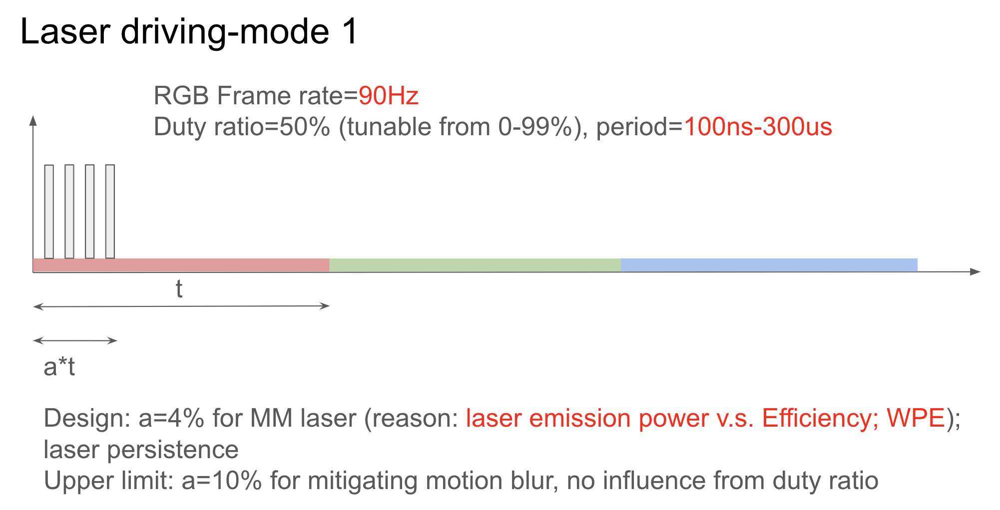

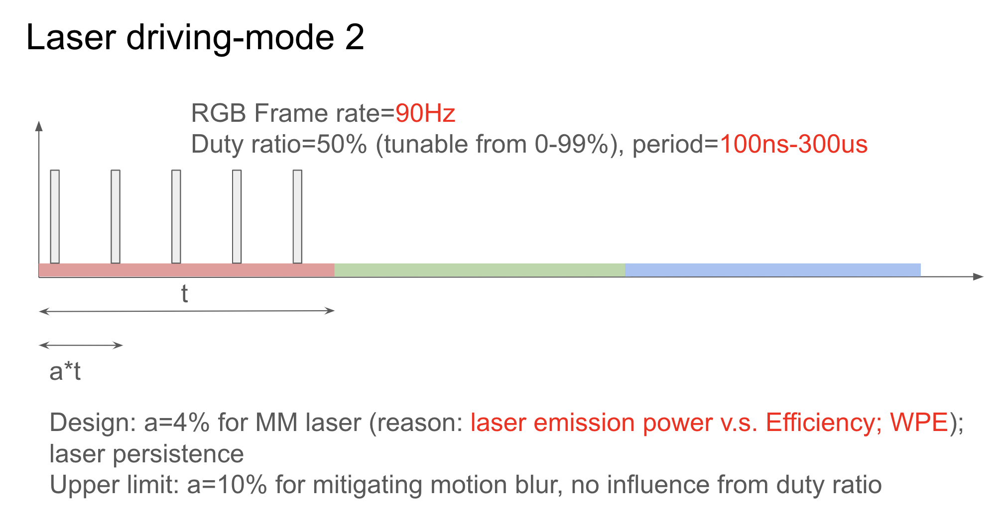

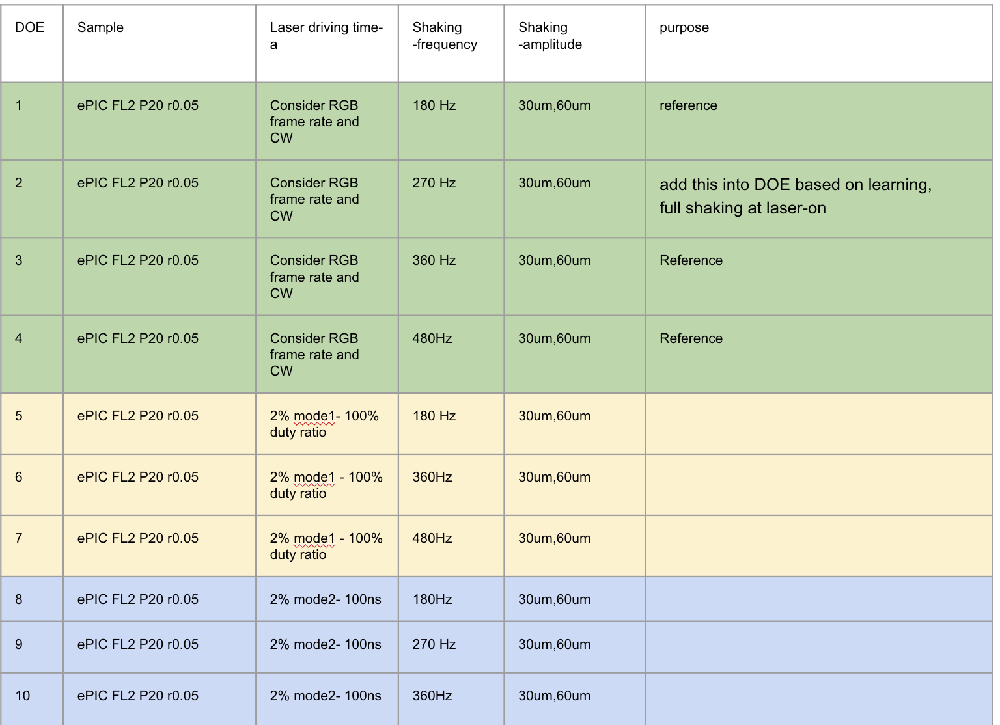

In [82]:
from IPython.display import display, Image

# Display an image file
display(Image(filename='/Users/qingjunwang/Documents/screenshots/mode1.png', width=500, height=300))
display(Image(filename='/Users/qingjunwang/Documents/screenshots/mode2.png', width=500, height=300))
display(Image(filename='/Users/qingjunwang/Documents/screenshots/driving DOE new.png', width=500, height=300))

```python
Eye integration time: 60Hz

within one eye integration cycle,lets first consider mechanical shaking cycles:
    for shaking frequency 180Hz: 3 cycles
    add this into DOE based on learning: for shaking frequency 270Hz: 4.5 cycles
    for shaking frequency 360Hz: 6 cycles
    for shaking frequency 480Hz: 8 cycles

And for different shaking frequency with different cycle numbers, lets mark down the portion when laser tuned on in each frequency:
    for color frame rate is 90Hz, within one eye integration time, it has 1.5 cyles of color frame
        considering color frame, for CW, within each cycle, there is only first 1/3 cycle the laser is on
        considering color frame, for 2% mode1 operation, within each cycle, there is only first 2%*1/3 cycle the laser is on
```

# DOE1-4: CW mode1

In [61]:
#CW mode1
def plot_shaking_and_laser_cycles_mode1(shaking_cycle,laser_cycle,laser_on_ratio):
    eye_integration_time = 1 / 60  # Eye integration frequency is 60Hz
    # shaking_cycle = 3  # Laser frequency is 90Hz
    # laser_cycle = 1.5  # Laser is on for the first 1/3 of each cycle
    shaking_total_angle=int(shaking_cycle*360) #in degree
    laser_cycle_angle_range=shaking_total_angle/laser_cycle
    i=0
    laser_on_angle_array=[]
    while laser_cycle_angle_range*i<shaking_total_angle:
        if (i+laser_on_ratio)*laser_cycle_angle_range<shaking_total_angle:
            laser_on_angle_array.append([i*laser_cycle_angle_range,(i+laser_on_ratio)*laser_cycle_angle_range])
        if (i+laser_on_ratio)*laser_cycle_angle_range>shaking_total_angle:
            laser_on_angle_array.append([i*laser_cycle_angle_range,shaking_total_angle])  
        i+=1
    print("angle range when laser turned on:", laser_on_angle_array)
    theta=np.array(range(0,shaking_total_angle,1))
    theta_in_rand=[x/180*np.pi for x in range(0,shaking_total_angle,1)]
    plt.figure(figsize=(4, 2))
    plt.title(f'Shaking frequency: {shaking_cycle*60}Hz, cycles of shaking:{shaking_cycle}')
    plt.plot(theta, np.sin(theta_in_rand), label='shaking Cycle')
    for anglerange in laser_on_angle_array:
        where=(theta >= anglerange[0]) & (theta <= anglerange[1])
        plt.fill_between(theta, np.sin(theta_in_rand), where=where, color='red', alpha=0.5, label='Laser On')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.ylabel('circle x amplitude')
    plt.xlabel('shaking angle within one eye integration cycle')
    # theta_in_rad=theta_in_rand
    # fig, axs = plt.subplots(1, len(laser_on_angle_array), figsize=(15, 3))
    # for idx, anglerange in enumerate(laser_on_angle_array):
    #     axs[idx].plot(theta, np.sin(theta_in_rad), label='Shaking Cycle', color='blue')
    #     where = (theta >= anglerange[0]) & (theta <= anglerange[1])
    #     axs[idx].fill_between(theta, np.sin(theta_in_rad), where=where, color='red', alpha=0.5, label='Laser On')
    #     axs[idx].set_title(f'Laser On: {anglerange[0]}° to {anglerange[1]}°')
    #     axs[idx].set_xlabel('Shaking angle (degrees)')
    #     if idx == 0:
    #         axs[idx].set_ylabel('Circle x amplitude')
    #     axs[idx].legend()
    # plt.tight_layout()
    # plt.show()

    return laser_on_angle_array

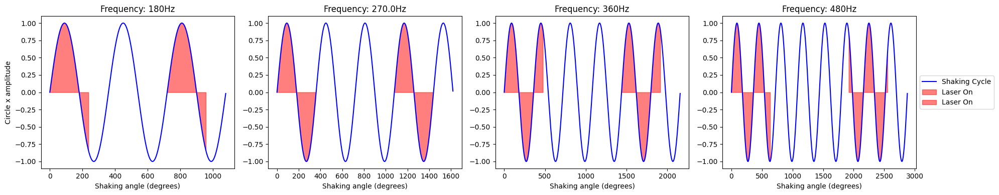

In [80]:
import numpy as np
import matplotlib.pyplot as plt

def plot_shaking_and_laser_cycles(shaking_frequencies, laser_cycle, laser_on_ratio):
    eye_integration_time = 1 / 60  # Eye integration frequency is 60Hz

    # Create a figure with subplots in one row, one for each frequency
    fig, axs = plt.subplots(1, len(shaking_frequencies), figsize=(5 * len(shaking_frequencies), 4))

    for idx, shaking_cycle in enumerate(shaking_frequencies):
        shaking_total_angle = int(shaking_cycle * 360)  # in degrees
        laser_cycle_angle_range = shaking_total_angle / laser_cycle

        i = 0
        laser_on_angle_array = []

        # Calculate the angle ranges where the laser is turned on
        while laser_cycle_angle_range * i < shaking_total_angle:
            start_angle = i * laser_cycle_angle_range
            end_angle = (i + laser_on_ratio) * laser_cycle_angle_range

            if end_angle < shaking_total_angle:
                laser_on_angle_array.append([start_angle, end_angle])
            else:
                laser_on_angle_array.append([start_angle, shaking_total_angle])
                break  # Exit the loop if the end angle exceeds the total angle

            i += 1

        theta = np.arange(0, shaking_total_angle, 1)
        theta_in_rad = theta / 180 * np.pi

        # Plot shaking cycle and laser on periods
        axs[idx].plot(theta, np.sin(theta_in_rad), label='Shaking Cycle', color='blue')
        for anglerange in laser_on_angle_array:
            where = (theta >= anglerange[0]) & (theta <= anglerange[1])
            axs[idx].fill_between(theta, np.sin(theta_in_rad), where=where, color='red', alpha=0.5, label='Laser On')
        
        axs[idx].set_title(f'Frequency: {shaking_cycle * 60}Hz')
        axs[idx].set_xlabel('Shaking angle (degrees)')
        if idx == 0:
            axs[idx].set_ylabel('Circle x amplitude')
        if idx == len(shaking_frequencies) - 1:
            axs[idx].legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.tight_layout()
    plt.show()

# Example usage with different frequencies
shaking_frequencies = [3, 4.5, 6,8]  # Different shaking cycles corresponding to different frequencies
laser_cycle = 1.5
laser_on_ratio = 0.33
plot_shaking_and_laser_cycles(shaking_frequencies, laser_cycle, laser_on_ratio)

angle range when laser turned on: [[0.0, 240.0], [720.0, 960.0]]
angle range when laser turned on: [[0.0, 360.0], [1080.0, 1440.0]]
angle range when laser turned on: [[0.0, 480.0], [1440.0, 1920.0]]
angle range when laser turned on: [[0.0, 640.0], [1920.0, 2560.0]]


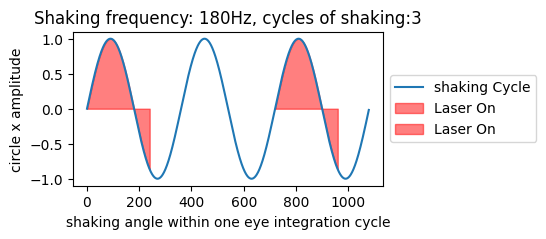

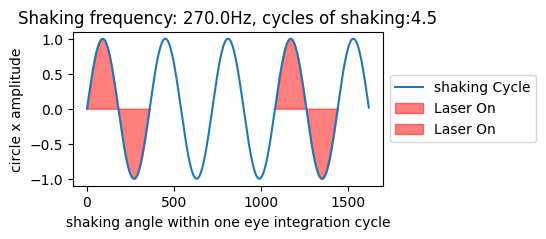

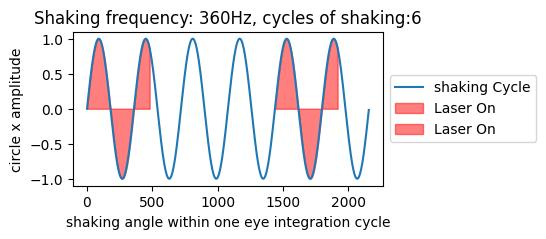

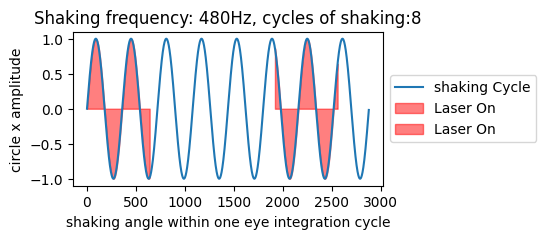

In [62]:
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(3,1.5,1/3)
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(4.5,1.5,1/3)
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(6,1.5,1/3)
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(8,1.5,1/3)

In [147]:
?shaking_scan_amplitude_laser_driving

Signature:
shaking_scan_amplitude_laser_driving(
    dic_images_key_path,
    amplitude_arr,
    image_pixel_per_um,
    select_color_chan,
    color,
    img_save_path,
    crop_middle_third,
    anglearr,
)
Docstring:
"
shaking simulation used for laser driving where I need arrs of shaking angle range
Parameters:
    dic_images_key_path(dic): {orginal_img_name(str):path(str)}
    amplitude_arr(arr): 
    image_pixel_per_um(float):
    select_color_chan(int): 0/1 for either grayscale image or color image
    color(str): 'red', 'green','blue'
    img_save_path(str):full path, ending at '/', and the system will create it if not exist
    crop_middle_third(int):0/1 for either non-crop or crop
    anglearr(list of list): look like [[0.0, 240.0], [720.0, 960.0]], from 0-240 degree and from 720 degree to 960 degree
return: contrast(dic,with tuple as dic key), contrast[(orginal_img_name,amplitude_arr[j])]=scaled_img.std()/scaled_img.mean()
File:      /var/folders/0r/tf9tj8xj6t986pfvvhtz7f5c0

image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE1
amp: 30 ,angle.min: 0.0 ,angle.max: 240.0 ,angle num: 66
finished one angle range
amp: 30 ,angle.min: 720.0 ,angle.max: 960.0 ,angle num: 66
finished one angle range
finished one angle array,for one amplitude
132


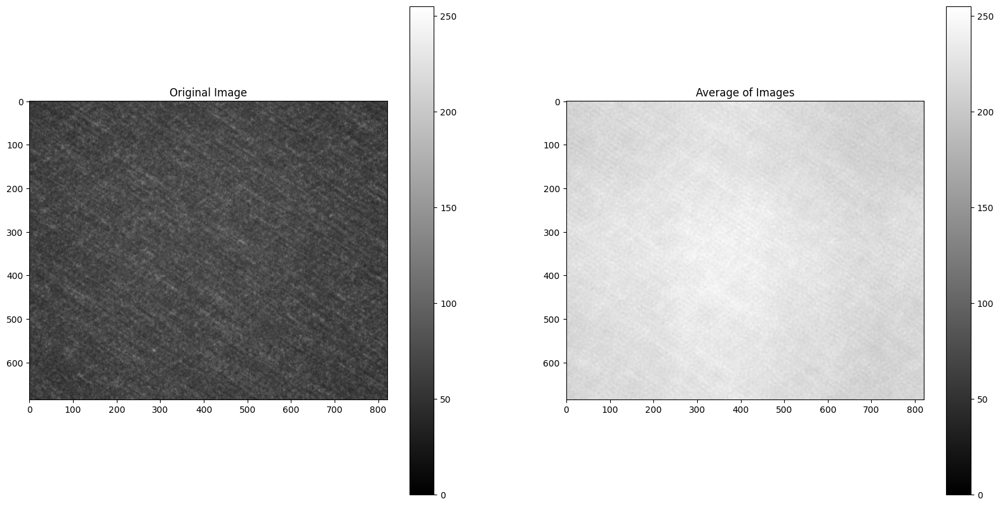

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE1_100points_30um_contrast0.03912928714315881.png
amp: 60 ,angle.min: 0.0 ,angle.max: 240.0 ,angle num: 133
finished one angle range
amp: 60 ,angle.min: 720.0 ,angle.max: 960.0 ,angle num: 133
finished one angle range
finished one angle array,for one amplitude
266


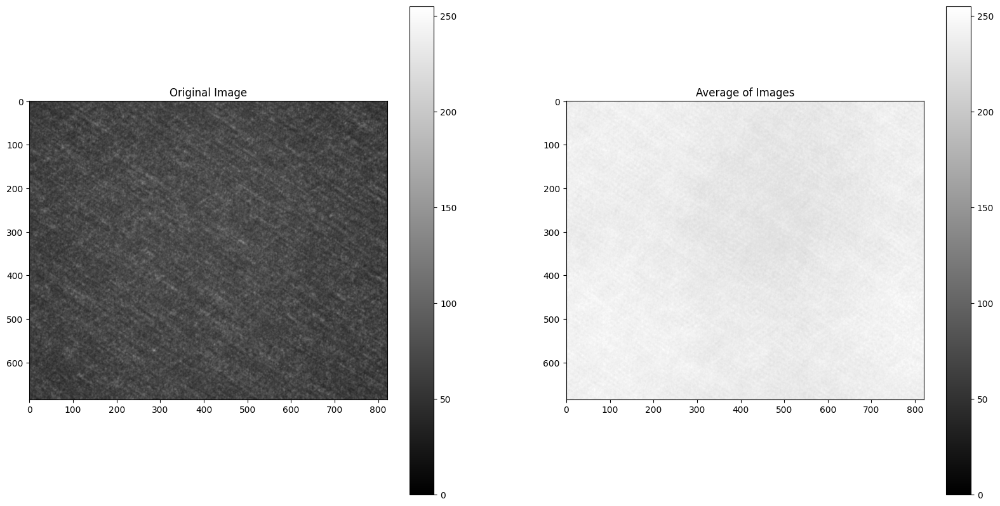

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE1_200points_60um_contrast0.021949304033943608.png
amp: 90 ,angle.min: 0.0 ,angle.max: 240.0 ,angle num: 200
finished one angle range
amp: 90 ,angle.min: 720.0 ,angle.max: 960.0 ,angle num: 200
finished one angle range
finished one angle array,for one amplitude
400


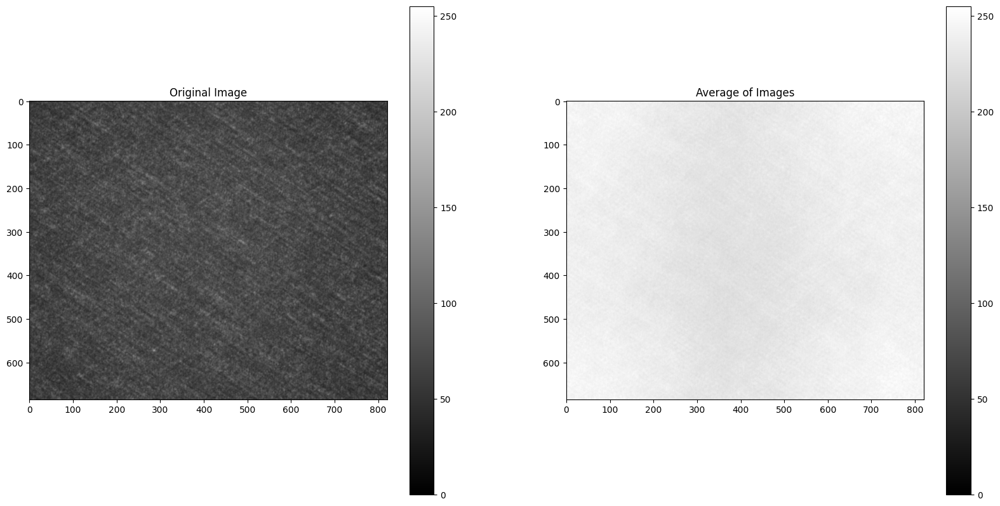

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE1_300points_90um_contrast0.027723191051099008.png


In [19]:
#shaking simulation

#full image:
# path="/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938.png"

#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE1":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 240.0], [720.0, 960.0]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE2
amp: 30 ,angle.min: 0.0 ,angle.max: 360.0 ,angle num: 100
finished one angle range
amp: 30 ,angle.min: 1080.0 ,angle.max: 1440.0 ,angle num: 100
finished one angle range
finished one angle array,for one amplitude
200


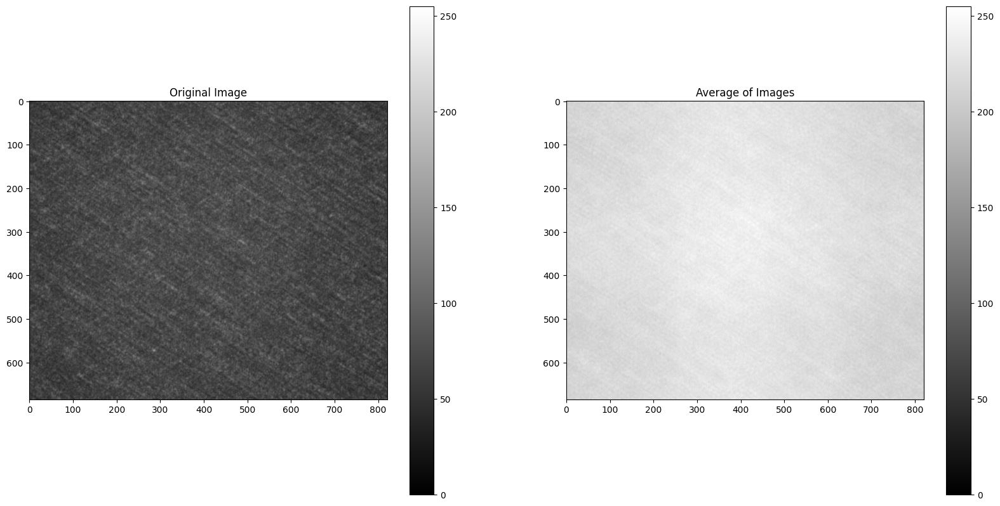

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE2_100points_30um_contrast0.03503639268028055.png
amp: 60 ,angle.min: 0.0 ,angle.max: 360.0 ,angle num: 200
finished one angle range
amp: 60 ,angle.min: 1080.0 ,angle.max: 1440.0 ,angle num: 200
finished one angle range
finished one angle array,for one amplitude
400


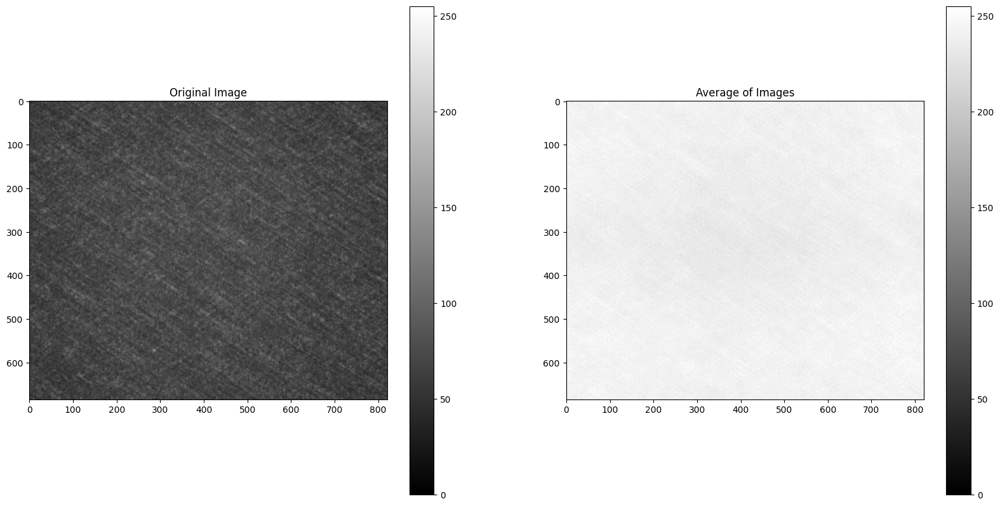

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE2_200points_60um_contrast0.016446086952709233.png
amp: 90 ,angle.min: 0.0 ,angle.max: 360.0 ,angle num: 300
finished one angle range
amp: 90 ,angle.min: 1080.0 ,angle.max: 1440.0 ,angle num: 300
finished one angle range
finished one angle array,for one amplitude
600


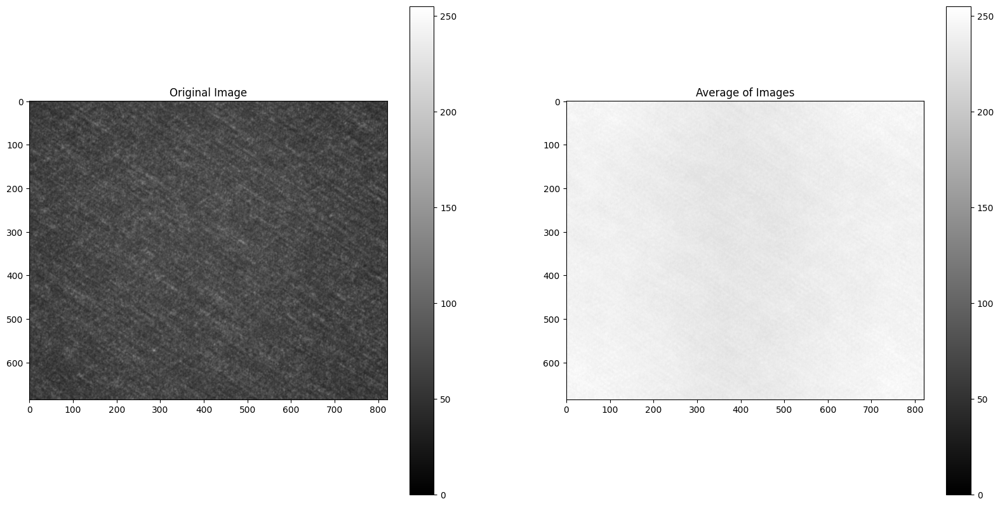

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE2_300points_90um_contrast0.022097191364307864.png


In [20]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE2":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 360.0], [1080.0, 1440.0]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE3
amp: 30 ,angle.min: 0.0 ,angle.max: 480.0 ,angle num: 133
finished one angle range
amp: 30 ,angle.min: 1440.0 ,angle.max: 1920.0 ,angle num: 133
finished one angle range
finished one angle array,for one amplitude
266


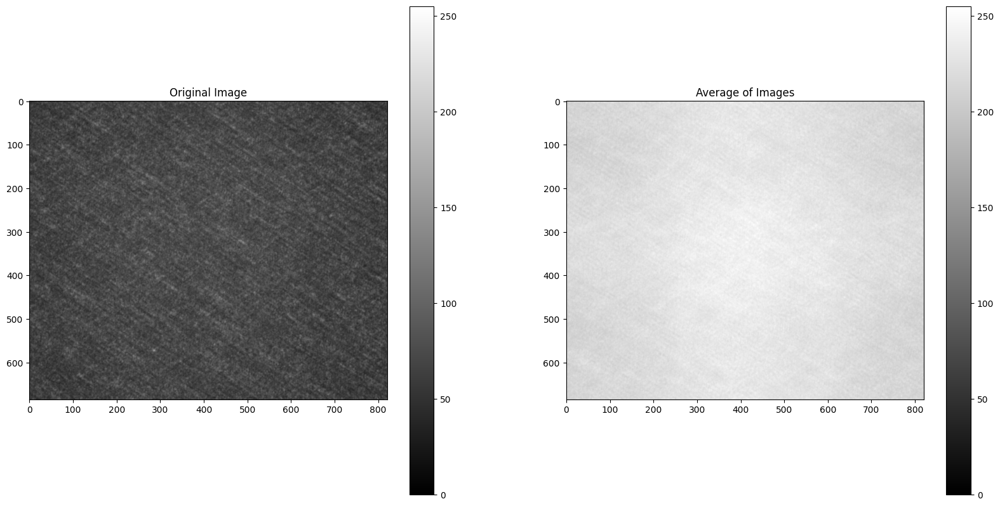

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE3_100points_30um_contrast0.036897150450717224.png
amp: 60 ,angle.min: 0.0 ,angle.max: 480.0 ,angle num: 266
finished one angle range
amp: 60 ,angle.min: 1440.0 ,angle.max: 1920.0 ,angle num: 266
finished one angle range
finished one angle array,for one amplitude
532


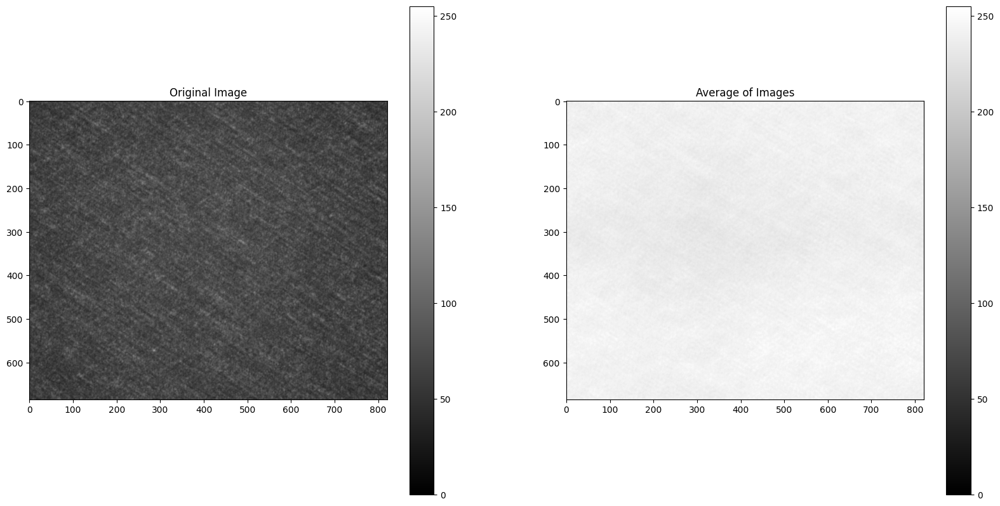

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE3_200points_60um_contrast0.0169924848655986.png
amp: 90 ,angle.min: 0.0 ,angle.max: 480.0 ,angle num: 400
finished one angle range
amp: 90 ,angle.min: 1440.0 ,angle.max: 1920.0 ,angle num: 400
finished one angle range
finished one angle array,for one amplitude
800


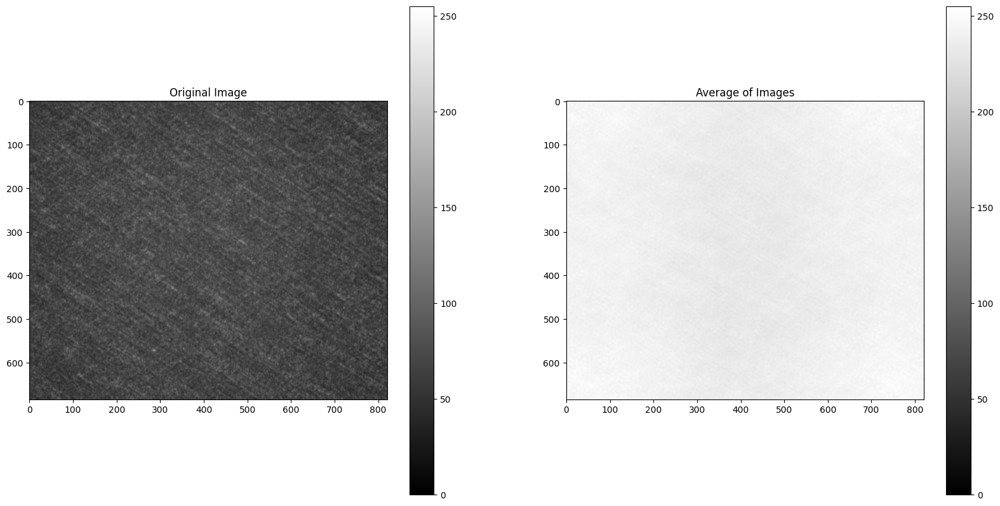

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE3_300points_90um_contrast0.020098310517522804.png


In [21]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE3":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 480.0], [1440.0, 1920.0]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE4
amp: 30 ,angle.min: 0.0 ,angle.max: 640.0 ,angle num: 177
finished one angle range
amp: 30 ,angle.min: 1920.0 ,angle.max: 2560.0 ,angle num: 177
finished one angle range
finished one angle array,for one amplitude
354


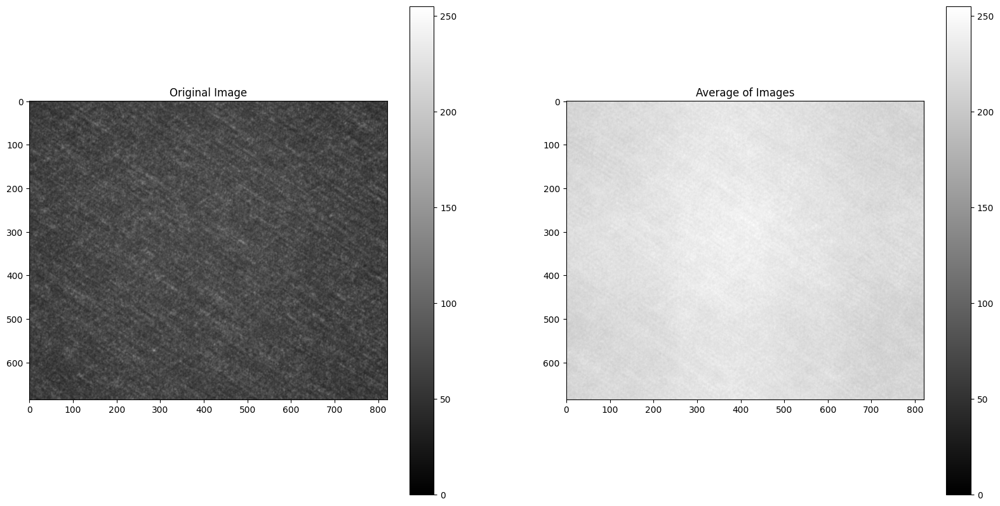

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE4_100points_30um_contrast0.03491438759258171.png
amp: 60 ,angle.min: 0.0 ,angle.max: 640.0 ,angle num: 355
finished one angle range
amp: 60 ,angle.min: 1920.0 ,angle.max: 2560.0 ,angle num: 355
finished one angle range
finished one angle array,for one amplitude
710


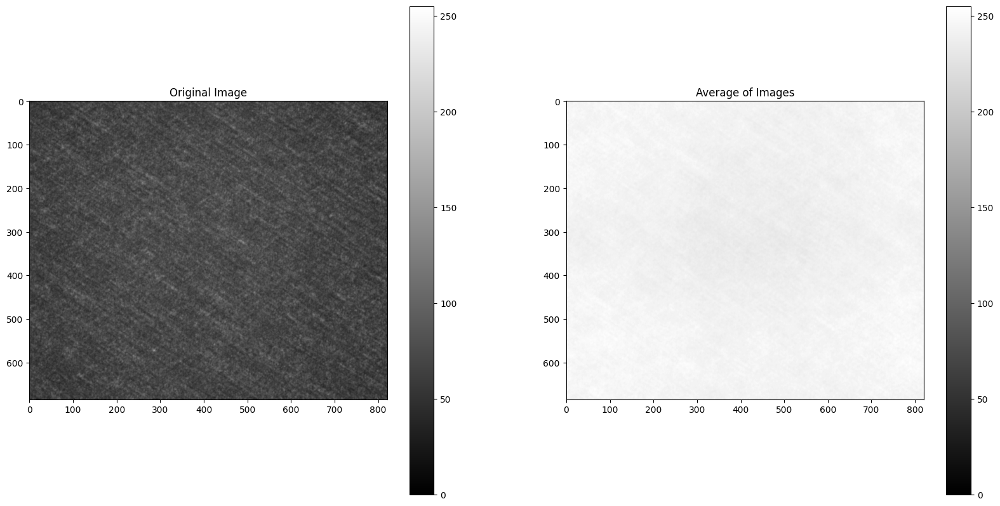

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE4_200points_60um_contrast0.015556545591373866.png
amp: 90 ,angle.min: 0.0 ,angle.max: 640.0 ,angle num: 533
finished one angle range
amp: 90 ,angle.min: 1920.0 ,angle.max: 2560.0 ,angle num: 533
finished one angle range
finished one angle array,for one amplitude
1066


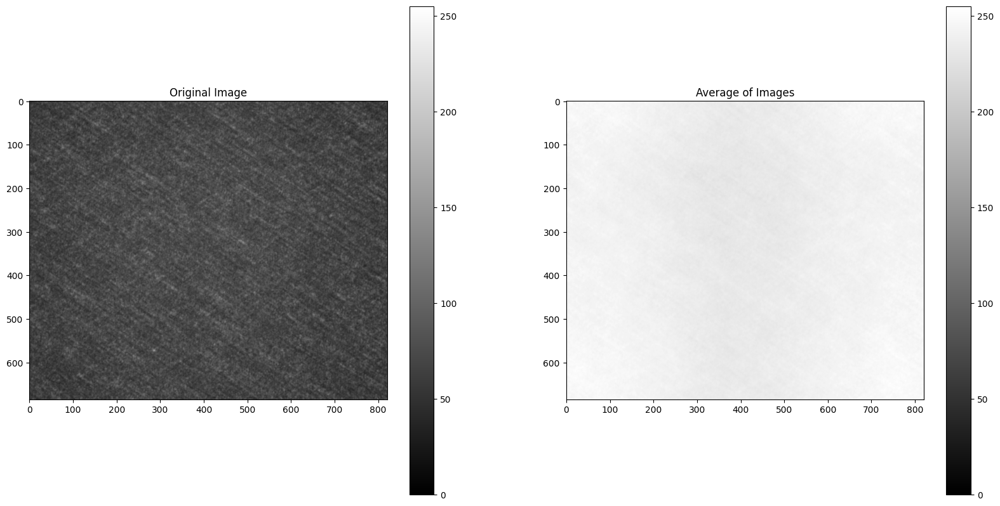

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE4_300points_90um_contrast0.02236493972714801.png


In [22]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE4":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 640.0], [1920.0, 2560.0]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

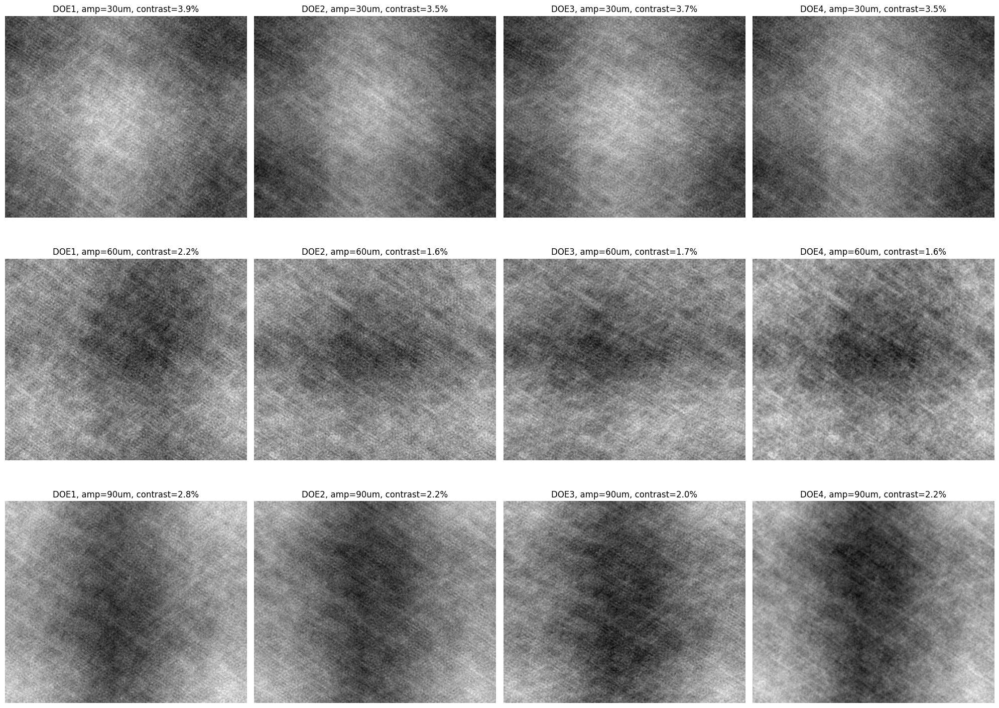

In [75]:
import os
import re
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

def load_images_from_folder(folder):
    images = {}
    for filename in os.listdir(folder):
        if filename.endswith(".png"):
            img = Image.open(os.path.join(folder, filename))
            if img is not None:
                # Extract details from filename
                match = re.search(r"DOE(\d+).*?(\d+)um_contrast([0-9.]+)", filename)
                if match:
                    doe = int(match.group(1))
                    amplitude = int(match.group(2))
                    contrast = float(match.group(3).rstrip('.'))
                    contrast_percentage = round(contrast * 100, 1)  # Convert to percentage and round
                    key = (doe, amplitude, contrast_percentage)
                    images[key] = np.array(img)
    return images

def normalize_images(images):
    # Find the minimum mean value among all images
    min_mean = min(np.mean(img) for img in images.values())
    
    # Normalize images to have the same mean value
    normalized_images = {key: img * (min_mean / np.mean(img)) for key, img in images.items()}
    return normalized_images

def save_normalized_images(images, folder_path):
    for key, img in images.items():
        doe, amplitude, contrast = key
        filename = f"DOE{doe}_amp{amplitude}um_contrast{contrast}%.png"
        Image.fromarray(img.astype('uint8')).save(os.path.join(folder_path, filename))

def plot_images(images):
    # Determine the layout of the subplots
    does = sorted(set(key[0] for key in images.keys()))
    amplitudes = sorted(set(key[1] for key in images.keys()))
    
    fig, axs = plt.subplots(len(amplitudes), len(does), figsize=(5 * len(does), 5 * len(amplitudes)))
    
    for i, amp in enumerate(amplitudes):
        for j, doe in enumerate(does):
            ax = axs[i, j] if len(amplitudes) > 1 else axs[j]
            key = next((k for k in images if k[0] == doe and k[1] == amp), None)
            if key:
                ax.imshow(images[key], cmap='gray')
                ax.set_title(f"DOE{doe}, amp={amp}um, contrast={key[2]}%")
                ax.axis('off')
            else:
                ax.axis('off')  # Turn off axis for empty subplots
    
    plt.tight_layout()
    plt.show()



folder_path = '/Users/qingjunwang/Documents/image files/laser driving simulation/doe1-4'
images = load_images_from_folder(folder_path)
normalized_images = normalize_images(images)
folder_path2 = '/Users/qingjunwang/Documents/image files/laser driving simulation/doe1-4/normalize'
save_normalized_images(normalized_images, folder_path2)  # Save each normalized image
plot_images(normalized_images)

```python
if within single laser on time, it covers more than one shaking cycle,means the laser turn-on time is not the bottleneck anymore

and we hope the laser turn on time can cover integer*mechanical shaking period, to give us best mechanical despeckling performance
```

# DOE5-7: 2% mode1 image for different cycles

angle range when laser turned on: [[0.0, 4.800000000000001], [720.0, 724.8]]
angle range when laser turned on: [[0.0, 7.2], [1080.0, 1087.1999999999998]]
angle range when laser turned on: [[0.0, 9.600000000000001], [1440.0, 1449.6]]
angle range when laser turned on: [[0.0, 12.8], [1920.0, 1932.8]]


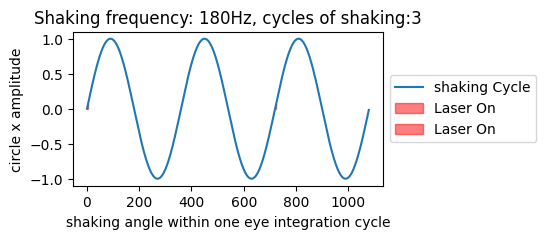

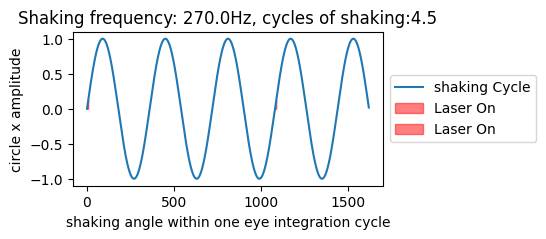

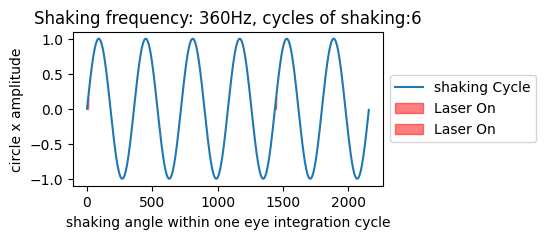

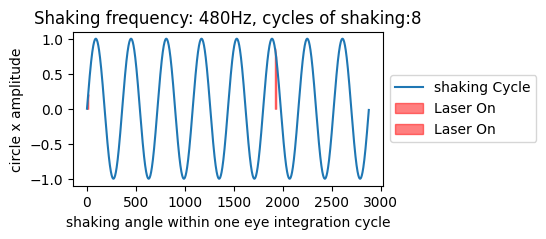

In [78]:
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(3,1.5,0.02*1/3)
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(4.5,1.5,0.02*1/3)
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(6,1.5,0.02*1/3)
laser_on_angle_array=plot_shaking_and_laser_cycles_mode1(8,1.5,0.02*1/3)

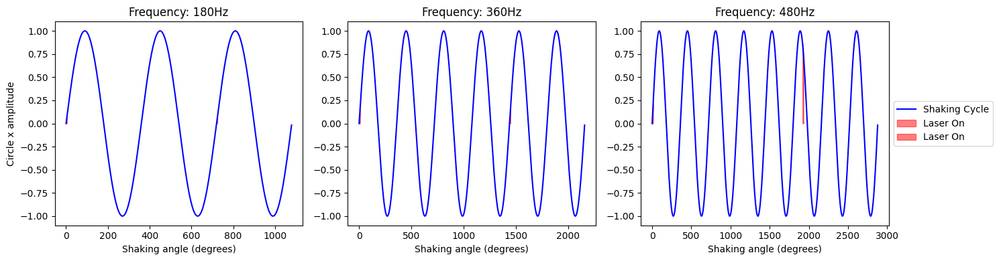

In [81]:
# Example usage with different frequencies
shaking_frequencies = [3, 6, 8]  # Different shaking cycles corresponding to different frequencies
laser_cycle = 1.5
laser_on_ratio = 0.33*0.02
plot_shaking_and_laser_cycles(shaking_frequencies, laser_cycle, laser_on_ratio)

In [101]:
x=100*np.tan(12/180*np.pi) #in um
print(x, 'um')

21.25565616700221 um


image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE5
amp: 30 ,angle.min: 0.0 ,angle.max: 0.0 ,angle num: 1
finished one angle range
amp: 30 ,angle.min: 720.0 ,angle.max: 720.0 ,angle num: 1
finished one angle range
finished one angle array,for one amplitude
2


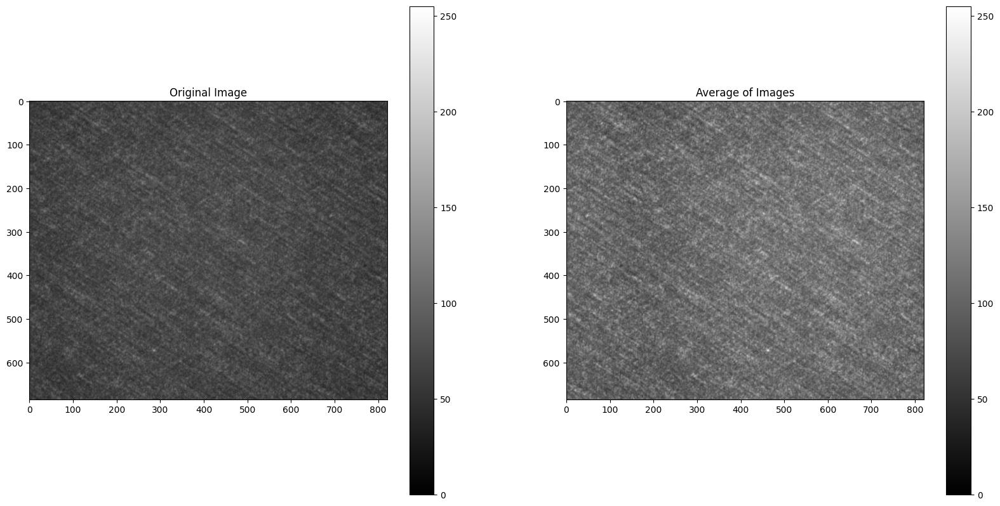

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE5_100points_30um_contrast0.15735279183579873.png
amp: 60 ,angle.min: 0.0 ,angle.max: 4.0 ,angle num: 2
finished one angle range
amp: 60 ,angle.min: 720.0 ,angle.max: 724.0 ,angle num: 2
finished one angle range
finished one angle array,for one amplitude
4


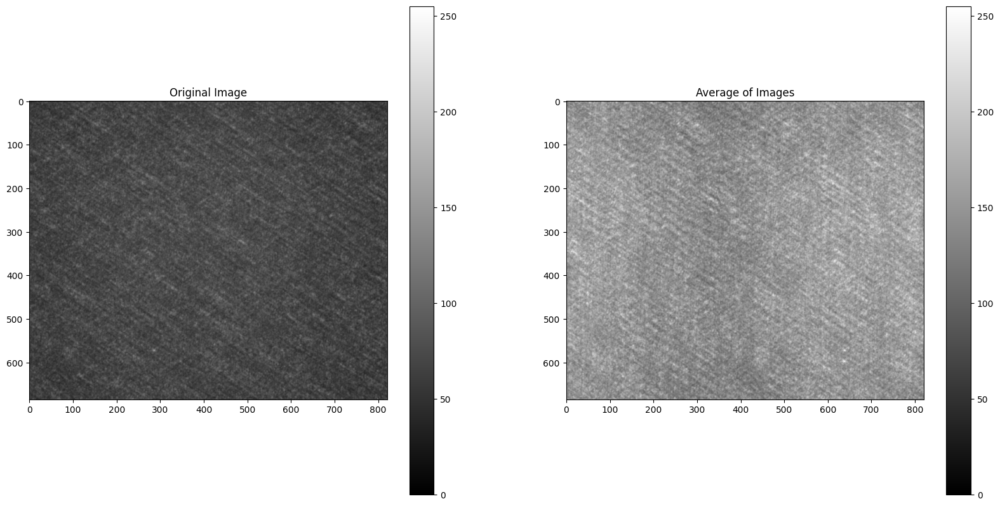

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE5_200points_60um_contrast0.11835470702664357.png
amp: 90 ,angle.min: 0.0 ,angle.max: 4.0 ,angle num: 4
finished one angle range
amp: 90 ,angle.min: 720.0 ,angle.max: 724.0 ,angle num: 3
finished one angle range
finished one angle array,for one amplitude
7


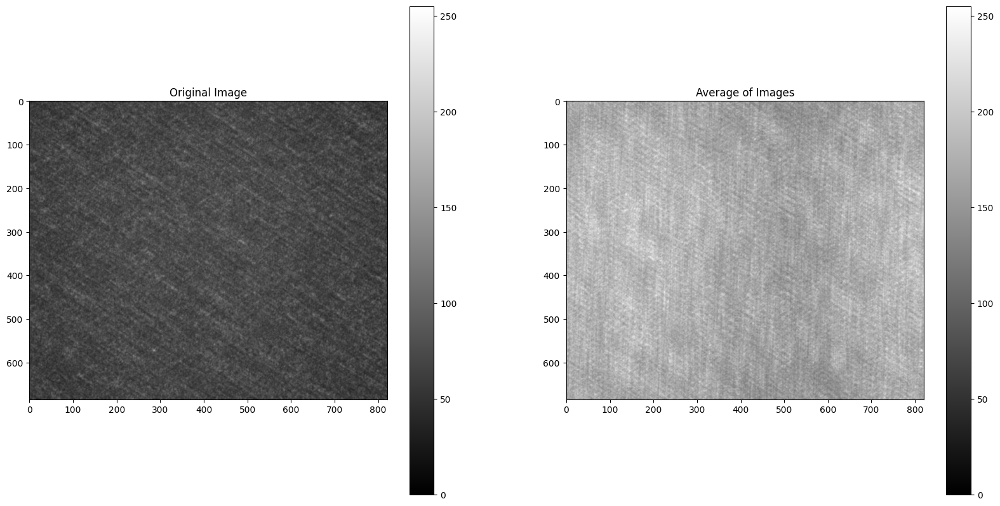

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE5_300points_90um_contrast0.0906122244335576.png


In [23]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE5":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 4.800000000000001], [720.0, 724.8]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

In [ ]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE5":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 7.2], [1080.0, 1087.1999999999998]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE6
amp: 30 ,angle.min: 0.0 ,angle.max: 9.0 ,angle num: 2
finished one angle range
amp: 30 ,angle.min: 1440.0 ,angle.max: 1449.0 ,angle num: 2
finished one angle range
finished one angle array,for one amplitude
4


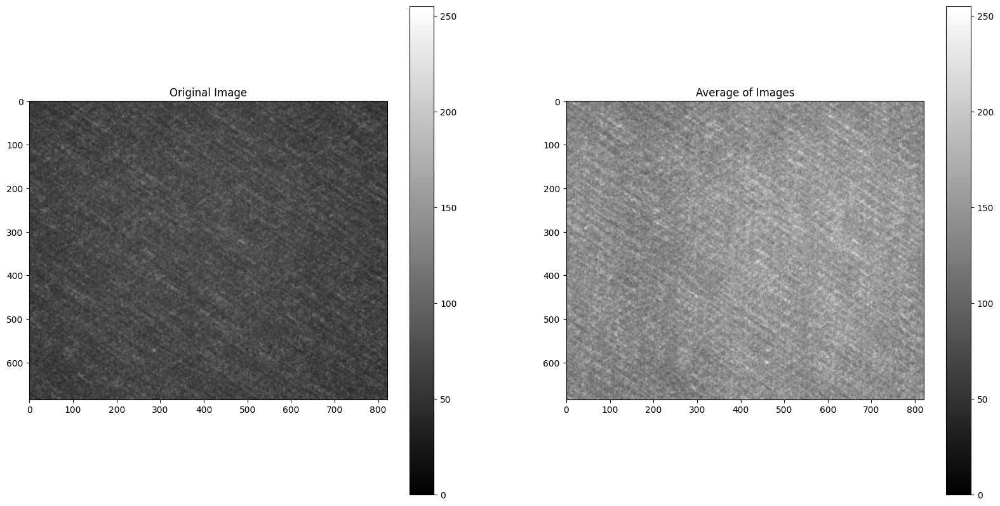

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE6_100points_30um_contrast0.11808390373370144.png
amp: 60 ,angle.min: 0.0 ,angle.max: 9.0 ,angle num: 5
finished one angle range
amp: 60 ,angle.min: 1440.0 ,angle.max: 1449.0 ,angle num: 5
finished one angle range
finished one angle array,for one amplitude
10


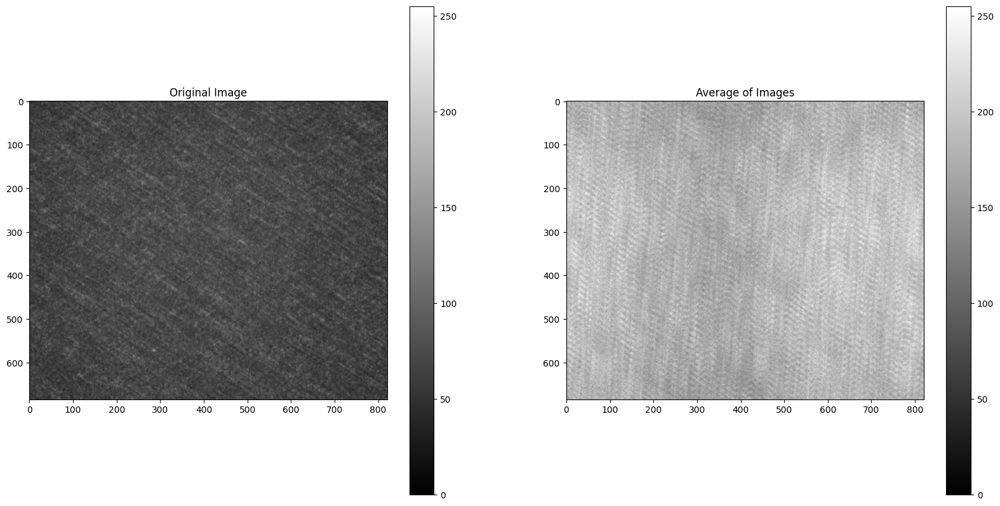

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE6_200points_60um_contrast0.08662849081227353.png
amp: 90 ,angle.min: 0.0 ,angle.max: 9.0 ,angle num: 8
finished one angle range
amp: 90 ,angle.min: 1440.0 ,angle.max: 1449.0 ,angle num: 7
finished one angle range
finished one angle array,for one amplitude
15


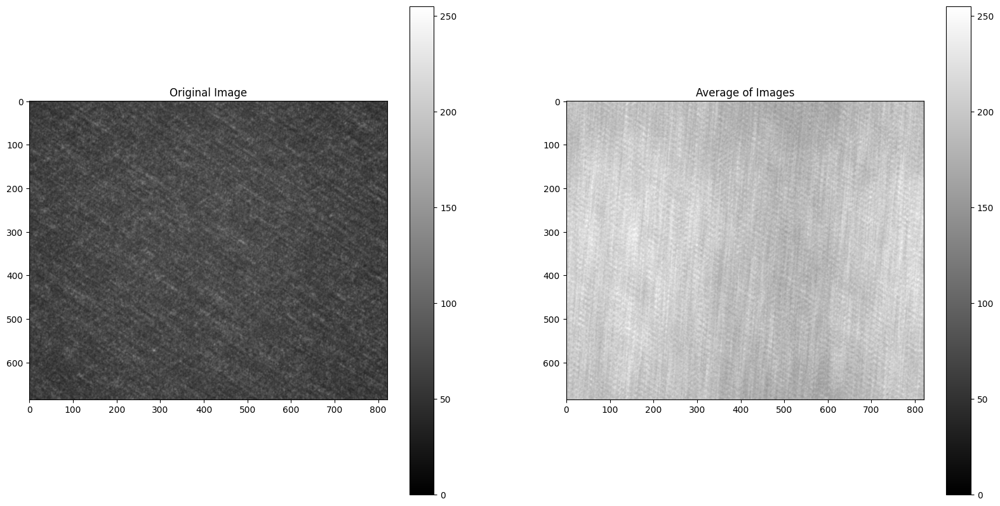

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE6_300points_90um_contrast0.07351622970884078.png


In [24]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE6":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 9.600000000000001], [1440.0, 1449.6]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

image loaded: ePIC_FL2_20um_r0.05_z2mm_DOE7
amp: 30 ,angle.min: 0.0 ,angle.max: 12.0 ,angle num: 3
finished one angle range
amp: 30 ,angle.min: 1920.0 ,angle.max: 1932.0 ,angle num: 3
finished one angle range
finished one angle array,for one amplitude
6


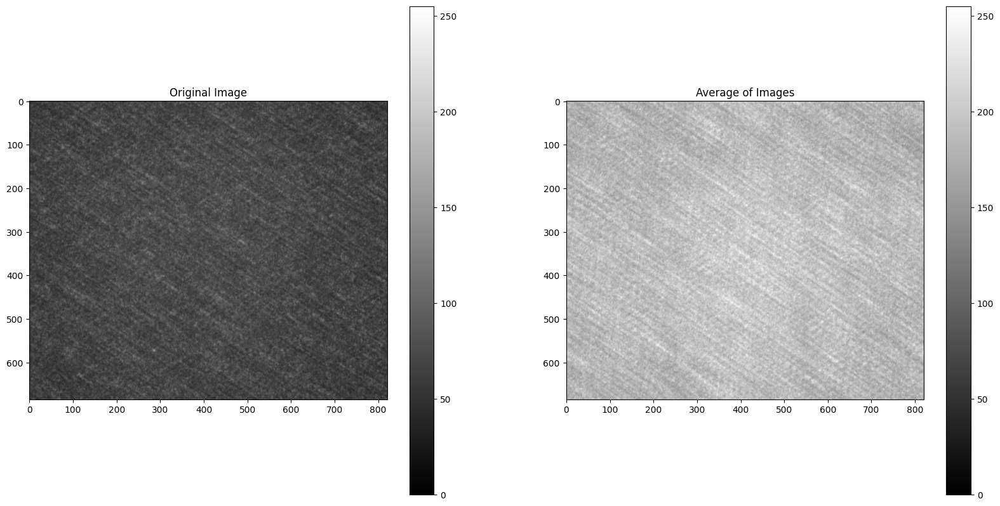

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE7_100points_30um_contrast0.07176675150628373.png
amp: 60 ,angle.min: 0.0 ,angle.max: 12.0 ,angle num: 7
finished one angle range
amp: 60 ,angle.min: 1920.0 ,angle.max: 1932.0 ,angle num: 7
finished one angle range
finished one angle array,for one amplitude
14


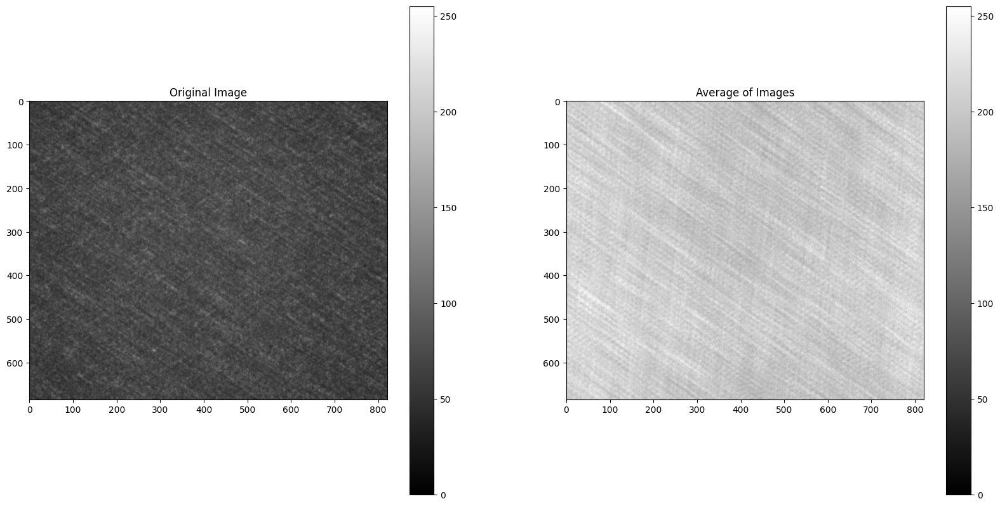

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE7_200points_60um_contrast0.05300466854899223.png
amp: 90 ,angle.min: 0.0 ,angle.max: 12.0 ,angle num: 10
finished one angle range
amp: 90 ,angle.min: 1920.0 ,angle.max: 1932.0 ,angle num: 10
finished one angle range
finished one angle array,for one amplitude
20


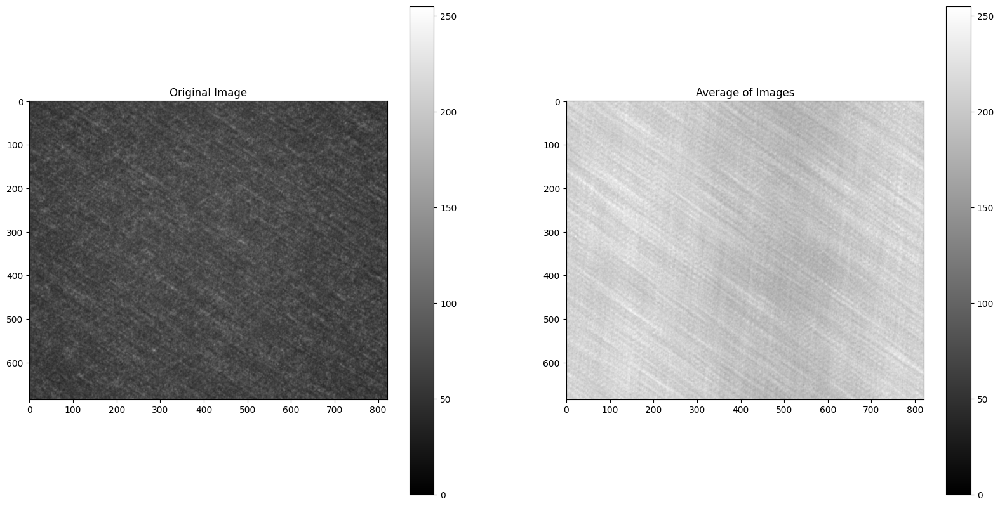

Image successfully saved to /Users/qingjunwang/Documents/image files/laser driving simulation/ePIC_FL2_20um_r0.05_z2mm_DOE7_300points_90um_contrast0.06225013708487106.png


In [25]:
#small image:
path='/Users/qingjunwang/Documents/image files/speckle 2 study/yuhang/YSSI_P20(XP10_YP20)_rSD_Green_single_image_folder/EPIC_FL2_D12C5_YSSI_P20_rSD_Green_50mA_25degrees_X0.000_Y0.000_Z33.606_Exp35938middle0.33.png'
dic_images_key_path={"ePIC_FL2_20um_r0.05_z2mm_DOE7":path}
amplitude_arr=[30,60,90]
image_pixel_per_um=2464 / 420 #chipview
select_color_chan=1
color='green'
img_save_path="/Users/qingjunwang/Documents/image files/laser driving simulation/"
crop_middle_third=0
anglearr=[[0.0, 12.8], [1920.0, 1932.8]]
contrast=shaking_scan_amplitude_laser_driving(dic_images_key_path, amplitude_arr, image_pixel_per_um, select_color_chan, color, img_save_path,crop_middle_third,anglearr)

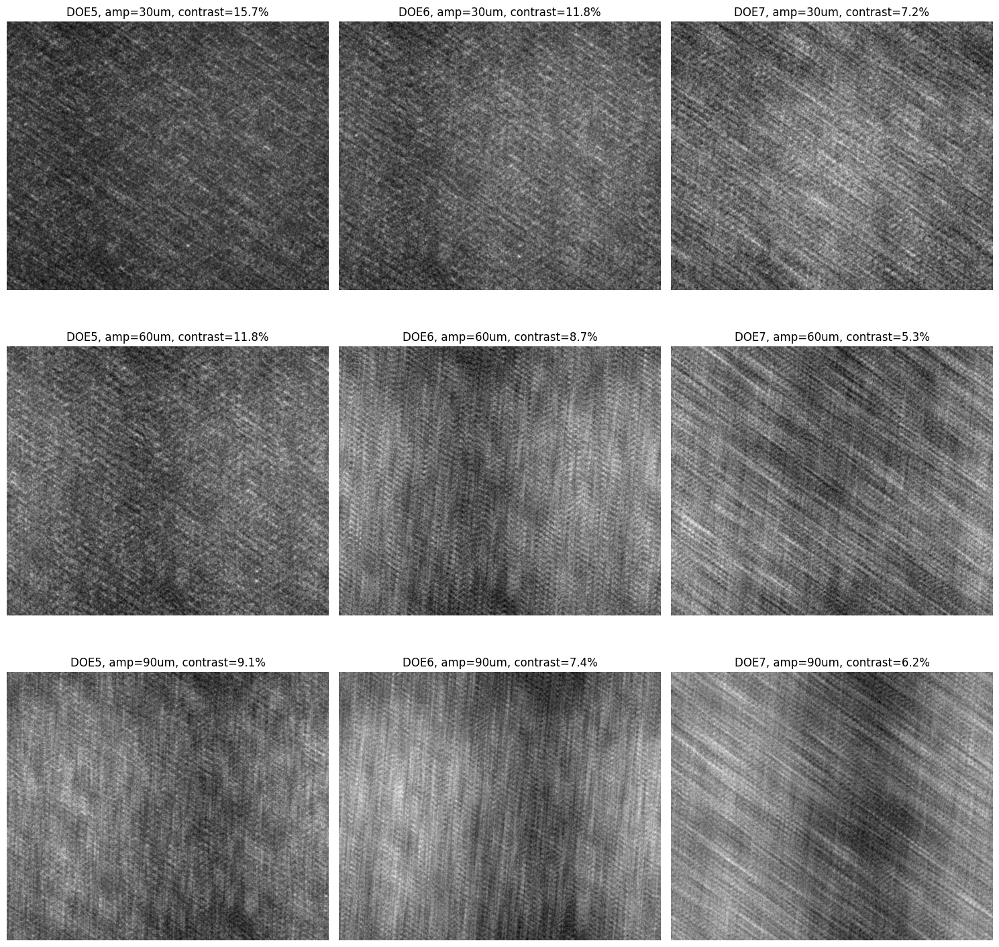

In [77]:
folder_path = '/Users/qingjunwang/Documents/image files/laser driving simulation/doe5-7'
images = load_images_from_folder(folder_path)
normalized_images = normalize_images(images)
folder_path2 = '/Users/qingjunwang/Documents/image files/laser driving simulation/doe5-7'
save_normalized_images(normalized_images, folder_path2)  # Save each normalized image
plot_images(normalized_images)

# DOE 8-11 2% mode2 image for different cycles

```python
DOE 8-11 compared to DOE1-4, the most important information is how many pulse sampling we get, 
Then evenly distrobute the pulses for CW simulation

Assumption: 
use 100ns laser on to have more sampling
eye integration time=1/60Hz=0.0167s

one color frame single color laser time=1/90/3=0.004s
consider a=2% laser turn on time: 0.004*0.02=8*10^-5s
num of pulses for one color frame single color laser time: 8*10^-5/(100*10^-9)=800

in laser all-on simulation, we use 3.3 points along trajectory for each 1um in shaking amplitude, 
(A100um use 300points) (see the converge test in the following image:)
800 sampling is more than enough for less than 2 mechanical shaking cycles, and we can treat this as CW case like what we considered in DOE1 and DOE2
```

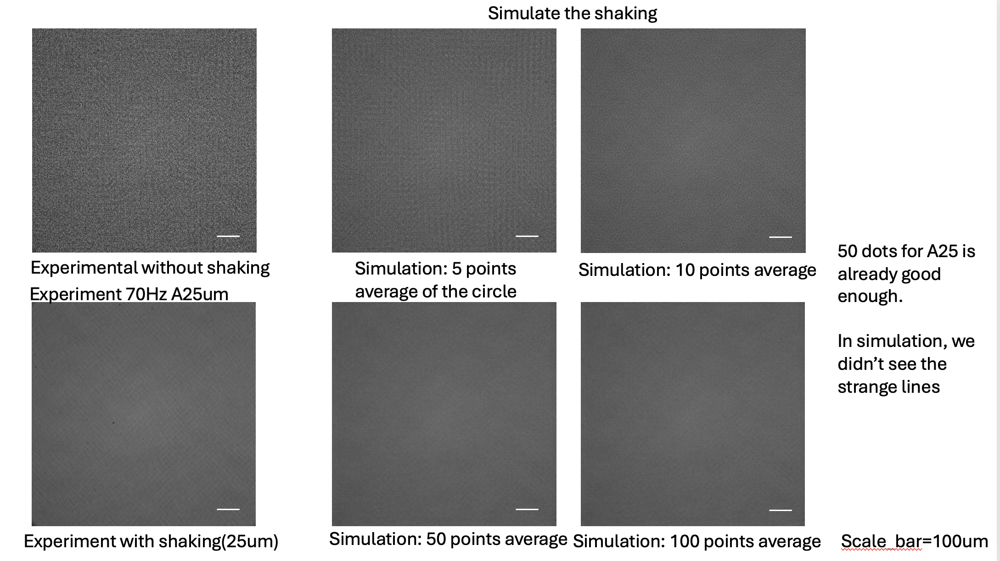

In [116]:
display(Image(filename='/Users/qingjunwang/Documents/screenshots/sampling threshhold.png', width=500, height=300))